In [ ]:
!nvidia-smi

Thu Aug 22 23:10:45 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   41C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
# Pip install method (recommended)

!pip install ultralytics==8.0.196

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.7/201.2 GB disk)


In [ ]:
from ultralytics import YOLO

from IPython.display import display, Image

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%cd {HOME}

!yolo task=detect mode=train model=yolov8x.pt data=/content/drive/dataset/data.yaml epochs=50 imgsz=512 plots=True batch=32

/content
New https://pypi.org/project/ultralytics/8.2.80 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=/content/datasets/Kdef-Emotions--2/data.yaml, epochs=50, patience=50, batch=32, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, vid_stride=1, stream_buffer=False, line_width=None, visualiz

In [ ]:
!ls {HOME}/runs/detect/train2/

args.yaml					    R_curve.png		 val_batch0_labels.jpg
confusion_matrix_normalized.png			    results.csv		 val_batch0_pred.jpg
confusion_matrix.png				    results.png		 val_batch1_labels.jpg
events.out.tfevents.1724368438.55eb034db692.1653.0  train_batch0.jpg	 val_batch1_pred.jpg
F1_curve.png					    train_batch1.jpg	 val_batch2_labels.jpg
labels_correlogram.jpg				    train_batch2.jpg	 val_batch2_pred.jpg
labels.jpg					    train_batch6120.jpg  weights
P_curve.png					    train_batch6121.jpg
PR_curve.png					    train_batch6122.jpg


/content


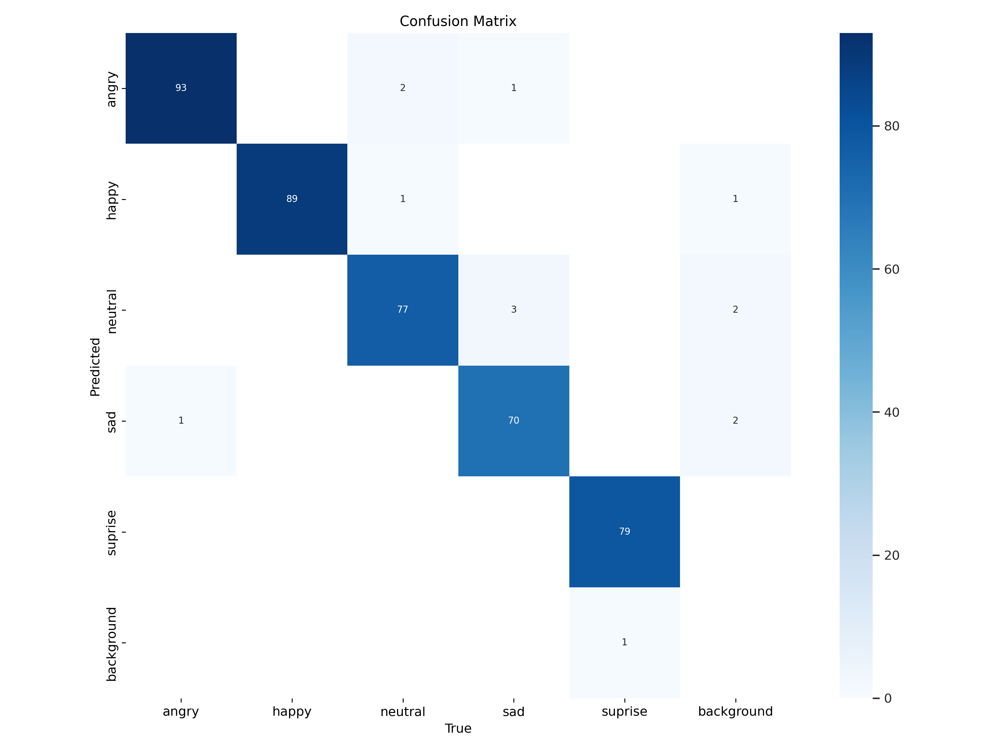

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/confusion_matrix.png', width=600)

/content


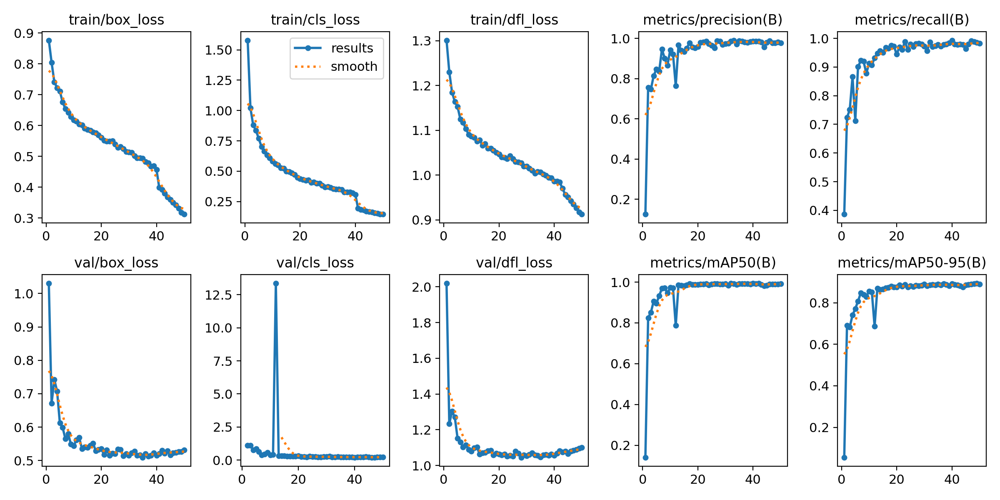

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/results.png', width=600)

/content


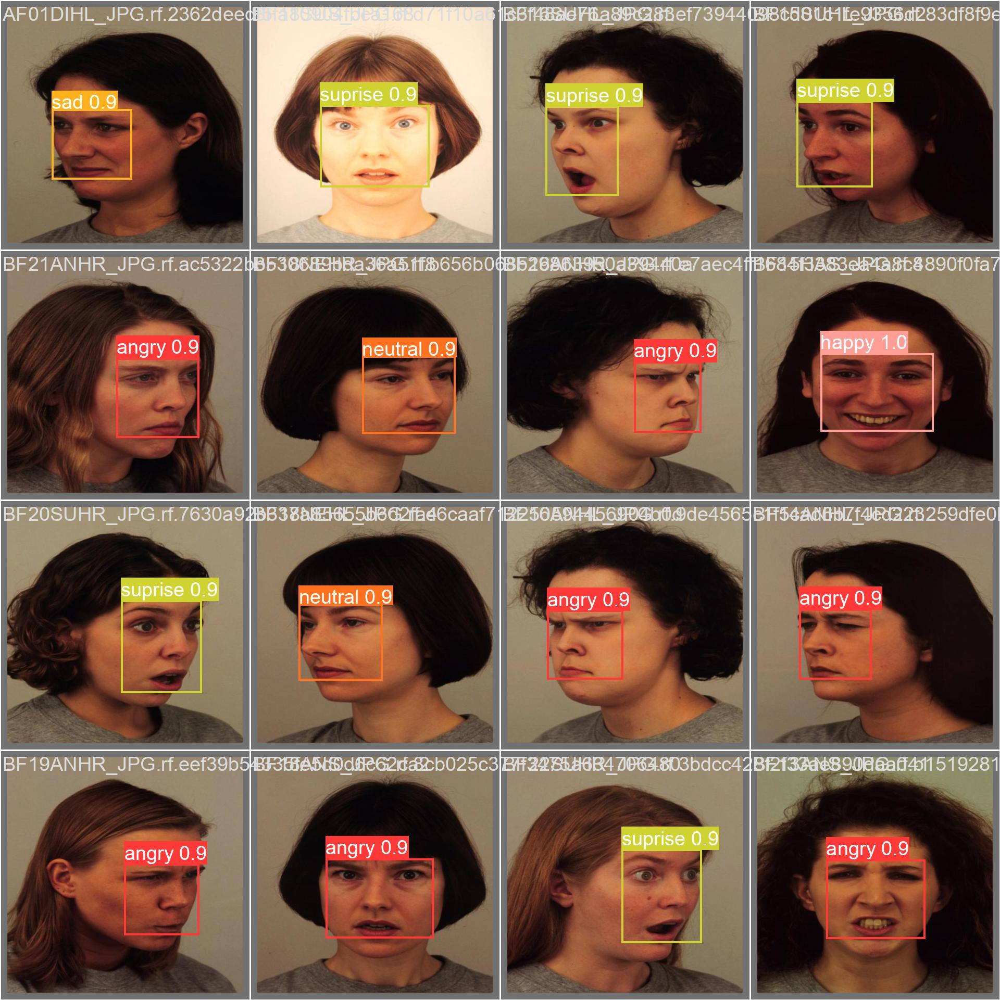

In [ ]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train2/val_batch0_pred.jpg', width=600)

In [ ]:
%cd {HOME}

!yolo task=detect mode=val model={HOME}/runs/detect/train2/weights/best.pt data=/content/drive/dataset/data.yaml

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 68128383 parameters, 0 gradients, 257.4 GFLOPs
val: Scanning /content/datasets/Kdef-Emotions--2/valid/labels.cache... 416 images, 0 backgrounds, 0 corrupt: 100% 416/416 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 26/26 [00:19<00:00,  1.34it/s]
                   all        416        417      0.981      0.985       0.99      0.893
                 angry        416         94      0.981      0.989      0.994      0.896
                 happy        416         89      0.982          1      0.995      0.907
               neutral        416         80      0.963       0.99      0.982      0.893
                   sad        416         74      0.986      0.959      0.988      0.883
               suprise        416         80      0.995      0.988      0.992      0.887
Speed: 1.3ms preproces

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train2/weights/best.pt conf=0.25 source=/content/drive/dataset/test/images save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 68128383 parameters, 0 gradients, 257.4 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/131 /content/datasets/Kdef-Emotions--2/test/images/AF01HAHL_JPG.rf.dfa19c10861647165f426555c2d290e1.jpg: 512x512 1 happy, 56.9ms
image 2/131 /content/datasets/Kdef-Emotions--2/test/images/AF03ANHL_JPG.rf.2a227af9daaf35d32aa44cc5ba79c5fe.jpg: 512x512 1 angry, 43.4ms
image 3/131 /content/datasets/Kdef-Emotions--2/test/images/AF03DIHR_JPG.rf.b05208b18cd4cd56c8a6aeadd405bcf6.jpg: 512x512 1 sad, 43.4ms
image 4/131 /content/datasets/Kdef-Emotions--2/test/images/AF07SAHL_JPG.rf.b3e68a44696a0ffcd1e46f46d6cbb2af.jpg: 512x512 1 sad, 39.7ms
image 5/131 /content/datasets/Kdef-Emotions--2/test/images/AF08SUHR_JPG.rf.583297562c79028b65971b7203623bb9.jpg: 512x512 1 suprise, 38.9ms
image 6/131 /content/datasets/Kdef-Emotions--2/test/images/AF10SAS_JPG.rf.270e6f899bb713628ee4f

In [ ]:
%cd {HOME}
!yolo task=detect mode=predict model={HOME}/runs/detect/train2/weights/best.pt conf=0.25 source=/content/testimgs save=True

/content
Ultralytics YOLOv8.0.196 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 268 layers, 68128383 parameters, 0 gradients, 257.4 GFLOPs

WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/15 /content/testimgs/IMG20240818185133.jpg: 512x384 1 happy, 82.5ms
image 2/15 /content/testimgs/IMG20240818185748.jpg: 512x384 1 neutral, 49.6ms
image 3/15 /content/testimgs/IMG20240818185919.jpg: 512x384 1 suprise, 49.6ms
image 4/15 /content/testimgs/IMG20240820070258.jpg: 512x384 1 happy, 49.6ms
image 5/15 /content/testimgs/IMG20240820070648.jpg: 512x384 1 sad, 49.6ms
image 6/15 /content/testimgs/IMG20240820070713.jpg: 512x384 1 angry, 49.7ms
image 7/15 /content/testimgs/IMG20240820071216.jpg: 512x384 1 neutral, 49.6ms
image 8/15 /content/testimgs/IMG20240820071929.jpg: 512x384 1 suprise, 49.6ms
image 9/15 /content/testimgs/IMG20240820071954 - Copy.jpg: 512x384 1 sad, 49.6ms
image 10/15 /content/testimgs/IMG20240820072041.jpg: 512x384 1 angry, 49.6ms
image 

**NOTE:** Let's take a look at few results.

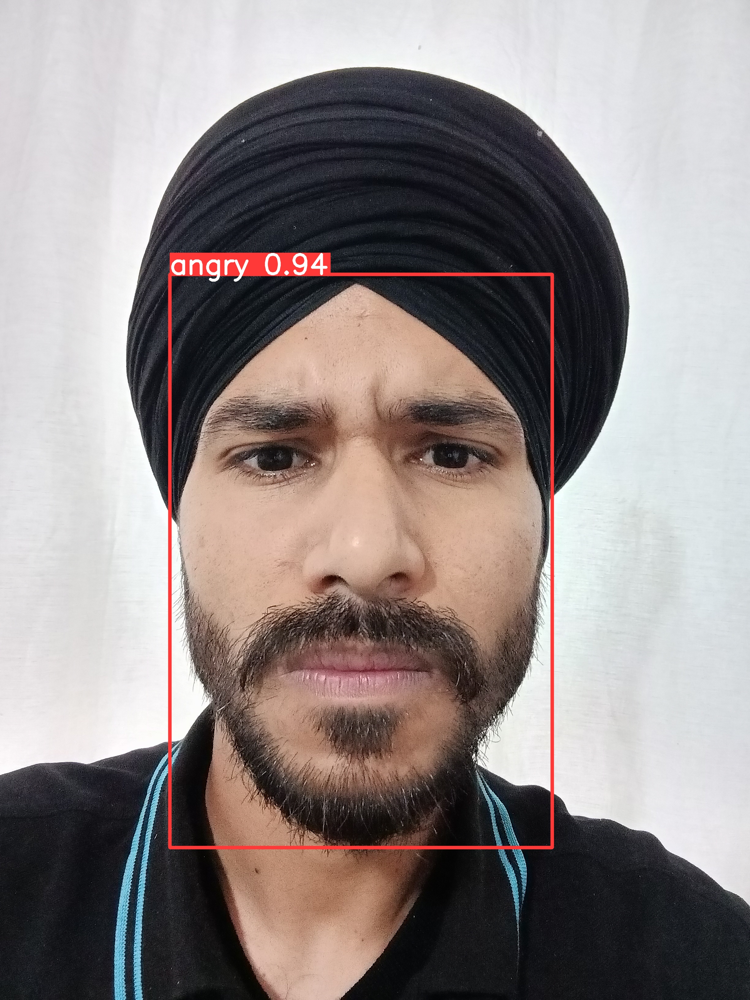

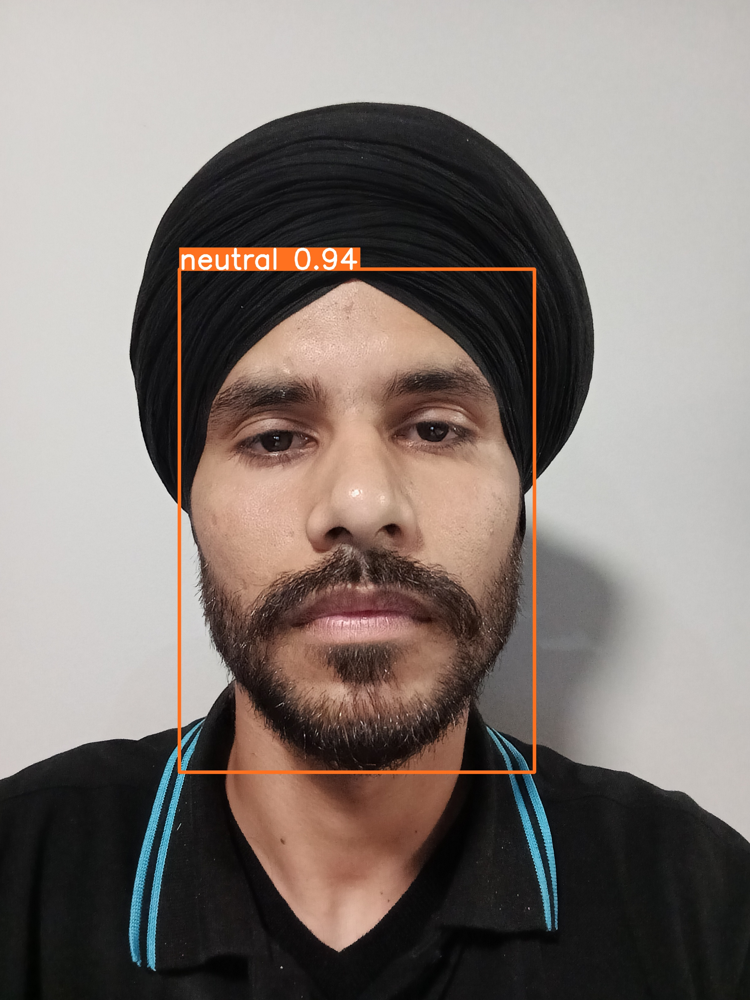

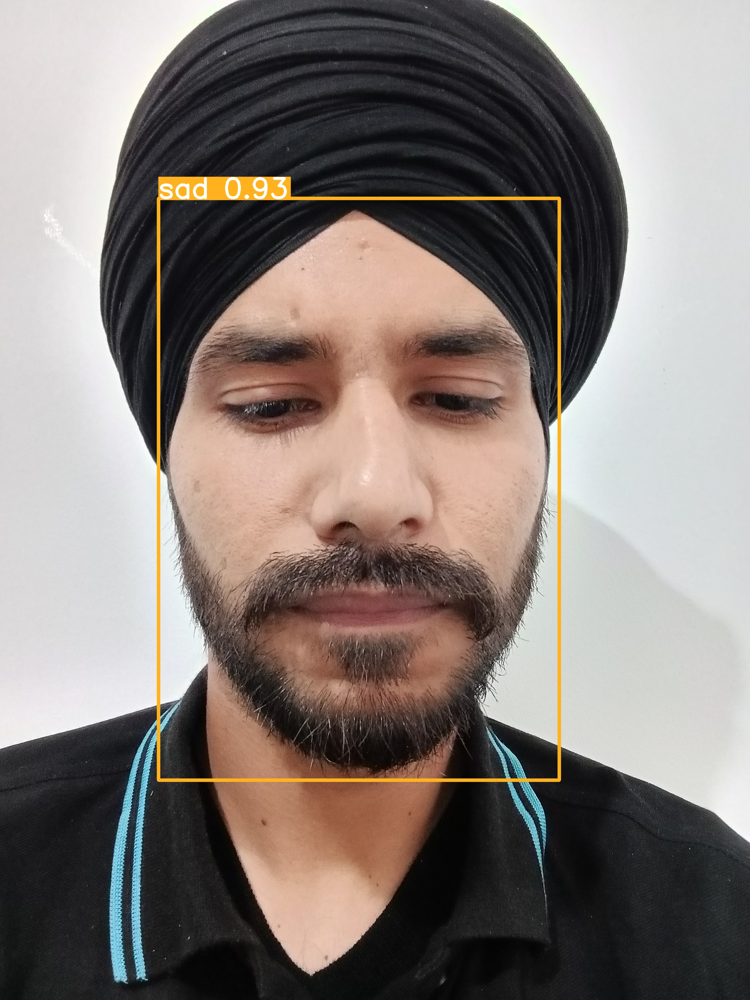

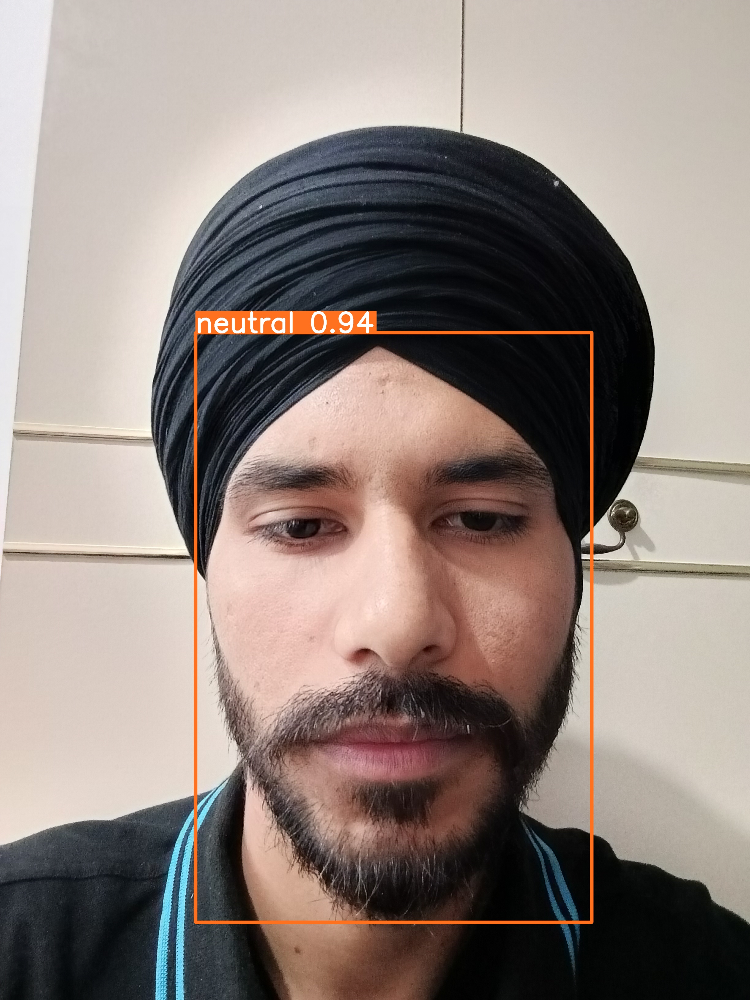

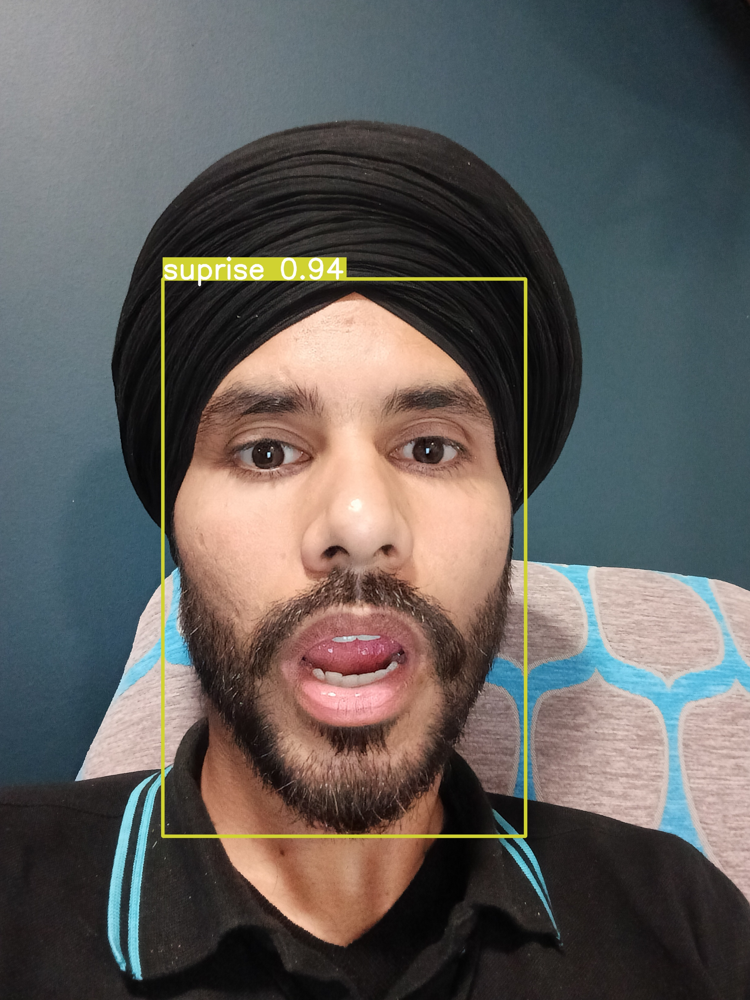

...

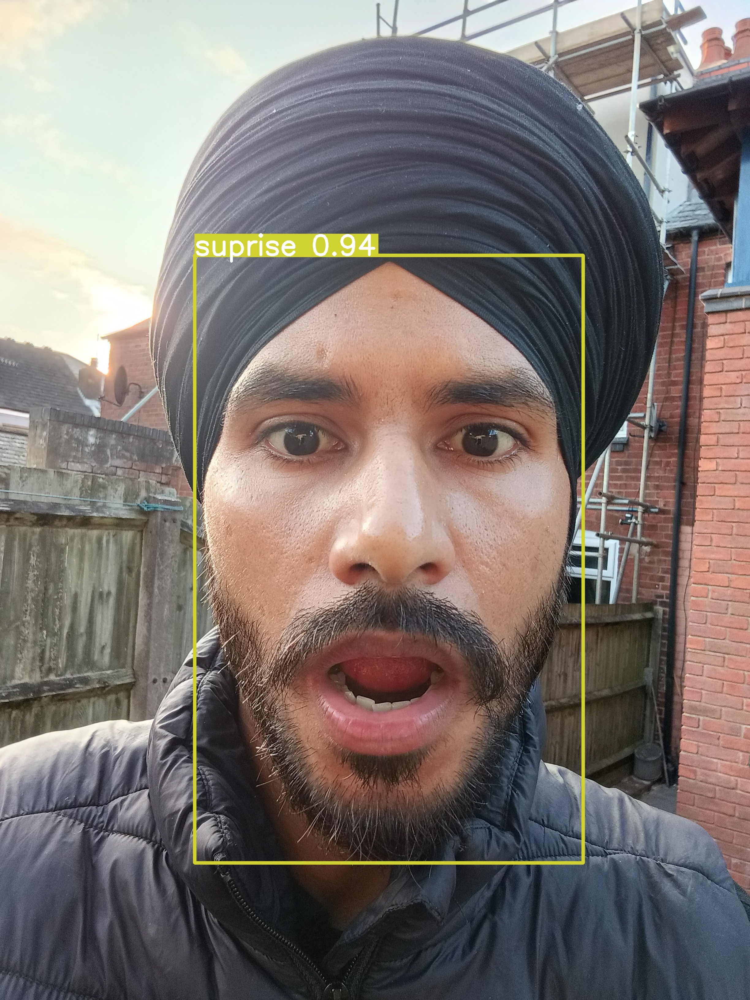

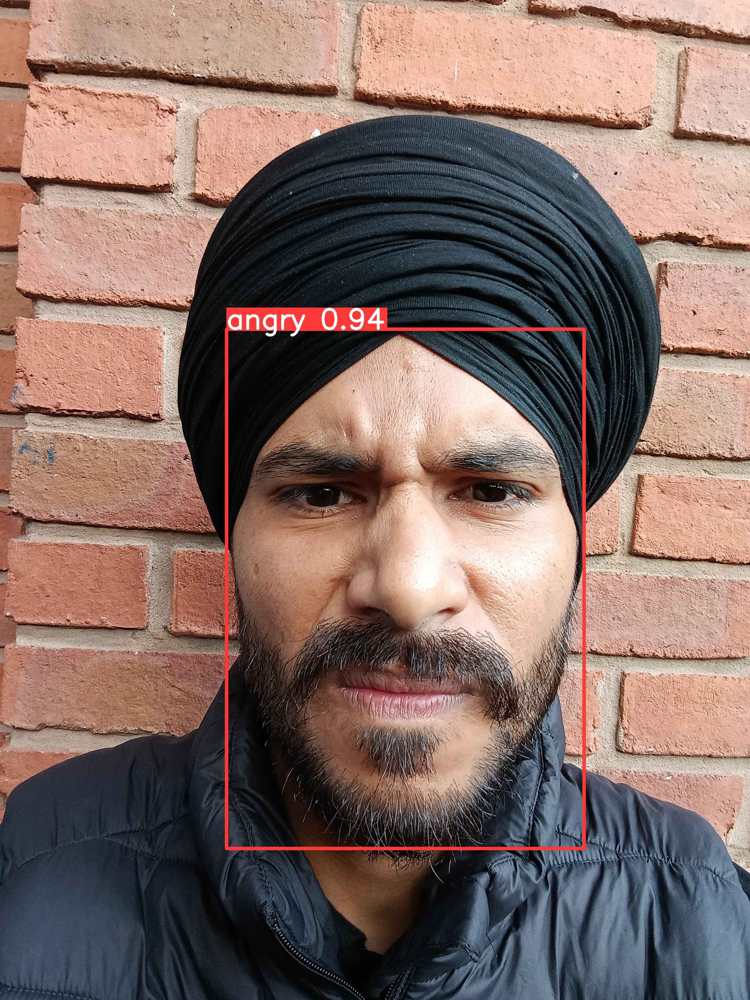

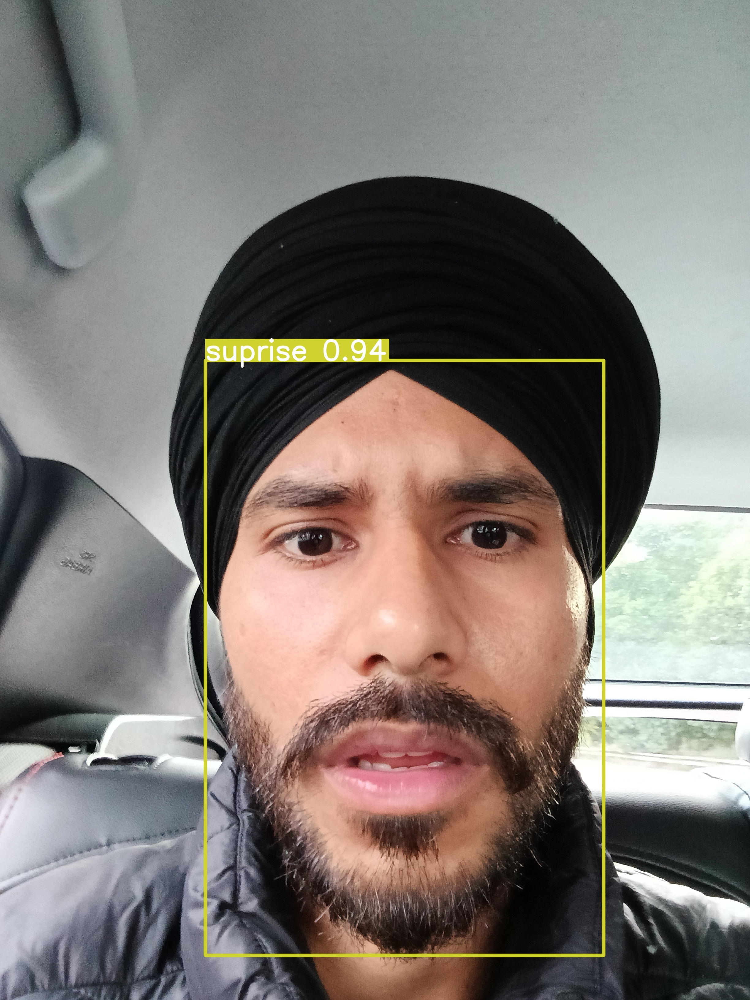

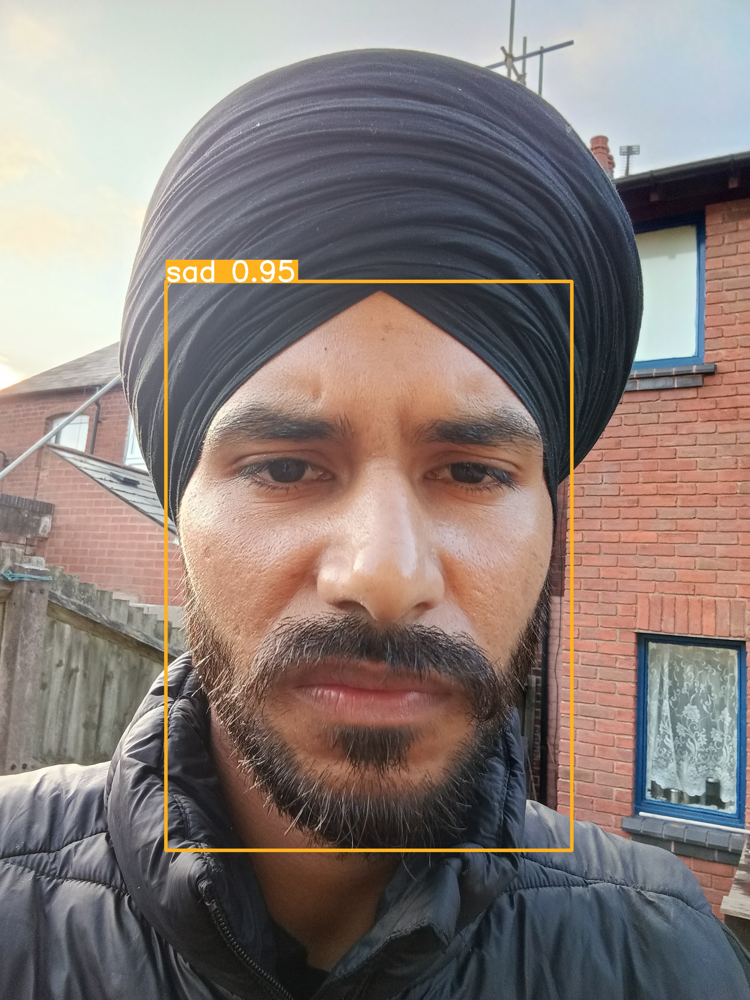

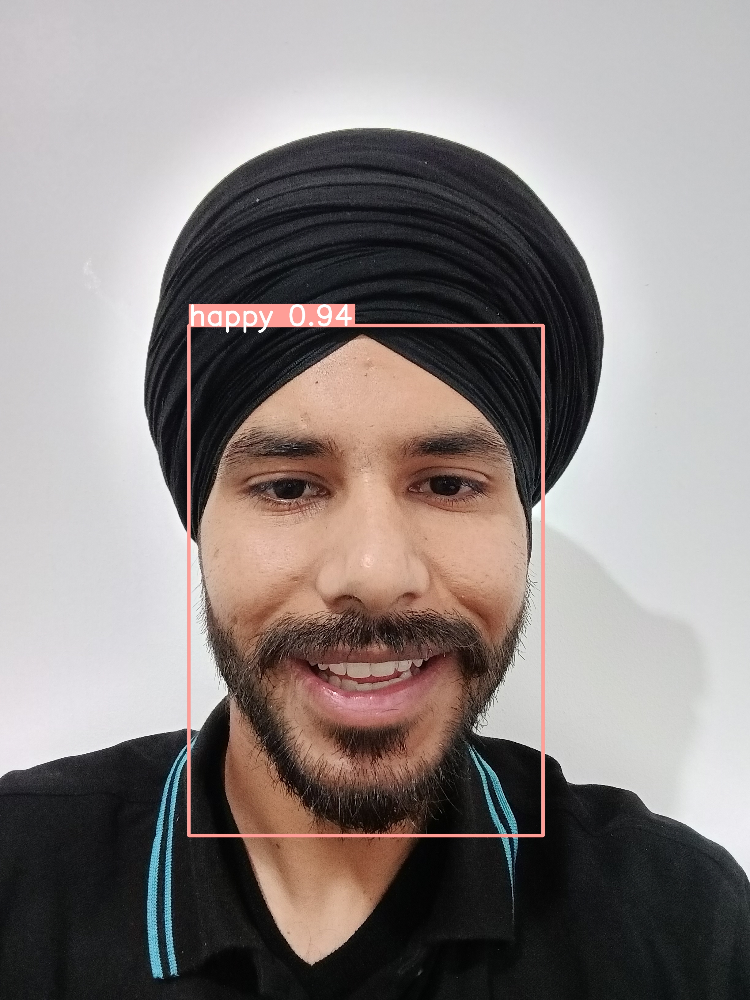

In [ ]:
import glob
from IPython.display import Image, display

# Define the base path where the folders are located
base_path = '/content/runs/detect/'

# List all directories that start with 'predict' in the base path
subfolders = [os.path.join(base_path, d) for d in os.listdir(base_path)
              if os.path.isdir(os.path.join(base_path, d)) and d.startswith('predict')]

# Find the latest folder by modification time
latest_folder = max(subfolders, key=os.path.getmtime)

image_paths = glob.glob(f'{latest_folder}/*.jpg')[:20]

# Display each image
for image_path in image_paths:
    display(Image(filename=image_path, width=600))
    print("\n")